# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle that contains information on 3 million used cars.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

In [ ]:
Looking at the available data, provide recommendations for used car dealerships to take decisions on what cars to have in 
inventory and sell, to maximize profit. 

In [ ]:
In order to provide this recommendation, we need to understand the available data, cleanup the data and then model it. 

In [ ]:
Analyze the models to find the key features and their weightage. Continously refine model as necessary.

In [ ]:
 Provide your best recommendations based on the generated models.

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

In [ ]:
1. Find datatypes of each feature. Understand what each feature captures and the range of values for each. 

In [ ]:
2. Plot values as necessary to gain further understanding of the data

In [ ]:
3. Look at the values to see if there are outliers. For example, this data set contains a small set of data for morgan
harley davidson etc. Remove these data as they are not significant.

In [ ]:
4. There is a small subset of cars sold over 250k and we dont have enough data to analyze classic cars. So remove
outliers.

In [ ]:
5. Find how many null values are in each column and deal with it appropriately. Decide to delete or update values.

### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [7]:
#Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

In [8]:
#load the data
df = pd.read_csv("C:/Users/fz8fd2/Downloads/data/vehicles.csv")

In [9]:
#Look at the top 5 rows to get a feel of the data
df.tail()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
426875,7301591192,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.0,clean,other,1N4AA6AV6KC367801,fwd,NaN,sedan,NaN,wy
426876,7301591187,wyoming,30590,2020.0,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,12029.0,clean,other,7JR102FKXLG042696,fwd,NaN,sedan,red,wy
426877,7301591147,wyoming,34990,2020.0,cadillac,xt4 sport suv 4d,good,NaN,diesel,4174.0,clean,other,1GYFZFR46LF088296,NaN,NaN,hatchback,white,wy
426878,7301591140,wyoming,28990,2018.0,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.0,clean,other,58ABK1GG4JU103853,fwd,NaN,sedan,silver,wy
426879,7301591129,wyoming,30590,2019.0,bmw,4 series 430i gran coupe,good,NaN,gas,22716.0,clean,other,WBA4J1C58KBM14708,rwd,NaN,coupe,NaN,wy


In [10]:
#find number of nulls in each column
df.isnull().sum(axis=0)

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

In [11]:
#Drop vin feature as it should not be influencing the price of the car
#Drop id as it should not be influencing the price and besides we have the row numbers
df = df.drop(['VIN', 'id'], 1)

C:\Users\fz8fd2\AppData\Local\Temp/ipykernel_15400/3128441938.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  df = df.drop(['VIN', 'id'], 1)


In [12]:
print(df['price'].mean())
print(df['price'].min())
print(df['price'].max())
print(df['price'].median())

print((df['price'] > 100000).sum())
df_classic = df[df['price'] > 100000]
df_classic

#There are 95 vehicles above $250k. I will consider them as classic vehicles and do separate analysis of classic and 
# ordinary vehicles. Removing expensive cars from the dataframe

df_no_classic = df[df['price'] < 100000]
print(df_no_classic['price'].mean())
print(df_no_classic['price'].min())
print(df_no_classic['price'].max())
print(df_no_classic['price'].median())

75199.0331873126
0
3736928711
13950.0
655
17265.191704033245
0
99999
13900.0


In [13]:
#Since this analysis is for used car dealership, I will also remove the new car details from analysis
df_no_classic_new = df_no_classic[df['condition'] != 'new']

C:\Users\fz8fd2\AppData\Local\Temp/ipykernel_15400/1126889323.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_no_classic_new = df_no_classic[df['condition'] != 'new']


In [14]:
#next lets look at year. Expectation is that greater the year, more the price

#let me also remove vehicles that are too old and not an expensive classic
df_no_classic_new_old = df_no_classic_new[df_no_classic_new['year'] > 2000]

#using year calculate age of the vehicle
df_no_classic_new_old['age'] = 2021 - df_no_classic_new_old['year']

C:\Users\fz8fd2\AppData\Local\Temp/ipykernel_15400/1418689655.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_no_classic_new_old['age'] = 2021 - df_no_classic_new_old['year']


In [15]:
df_no_classic_new_old['manufacturer'].unique()

array(['gmc', 'chevrolet', 'toyota', 'ford', 'jeep', 'nissan', 'ram',
       'mazda', 'cadillac', 'honda', 'dodge', 'lexus', 'jaguar', 'buick',
       'chrysler', 'volvo', 'audi', 'infiniti', 'lincoln', 'alfa-romeo',
       'subaru', nan, 'acura', 'hyundai', 'mercedes-benz', 'bmw',
       'mitsubishi', 'volkswagen', 'porsche', 'kia', 'rover', 'ferrari',
       'mini', 'pontiac', 'fiat', 'tesla', 'saturn', 'mercury',
       'harley-davidson', 'aston-martin', 'land rover', 'morgan'],
      dtype=object)

In [16]:
#Since we are talking recommendations for used car dealerships, we will remove harley_davidson. There are only 135 data points 
#for harley anyway. Morgan has 1 data point, hence remove it as well
#aston-martin, ferrari, land rover, alfa-romeo, fiat, mercury, tesla - remove as too few data points
remove_manufacturers = {'harley-davidson', 'morgan'}

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old["manufacturer"] !=  'harley-davidson']

print((df_no_classic_new_old['manufacturer'] == 'harley-davidson').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'morgan']
print((df_no_classic_new_old['manufacturer'] == 'morgan').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'aston-martin']
print((df_no_classic_new_old['manufacturer'] == 'aston-martin').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'ferrari']
print((df_no_classic_new_old['manufacturer'] == 'ferrari').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'land rover']
print((df_no_classic_new_old['manufacturer'] == 'land rover').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'alfa-romeo']
print((df_no_classic_new_old['manufacturer'] == 'alfa-romeo').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'fiat']
print((df_no_classic_new_old['manufacturer'] == 'fiat').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'mercury']
print((df_no_classic_new_old['manufacturer'] == 'mercury').sum())

df_no_classic_new_old = df_no_classic_new_old[df_no_classic_new_old['manufacturer'] != 'tesla']
print((df_no_classic_new_old['manufacturer'] == 'tesla').sum())

df_no_classic_new_old_hd = df_no_classic_new_old

0
0
0
0
0
0
0
0
0


In [17]:
#find number of nulls in each column
df_no_classic_new_old_hd.isnull().sum(axis=0)

region               0
price                0
year                 0
manufacturer     12501
model             3457
condition       163486
cylinders       166149
fuel              2665
odometer          4224
title_status      7736
transmission      2405
drive           119034
size            284885
type             80900
paint_color     118546
state                0
age                  0
dtype: int64

In [18]:
#odometer is an important metric. Since there are only 4k rows with no odometer lets drop those rows
df_no_classic_new_old_hd = df_no_classic_new_old_hd[df_no_classic_new_old_hd['odometer'].notna()]

In [19]:
df_no_classic_new_old_hd.isnull().sum(axis=0)

region               0
price                0
year                 0
manufacturer     12329
model             3447
condition       161121
cylinders       163384
fuel              2095
odometer             0
title_status      7174
transmission      1629
drive           117662
size            281430
type             80045
paint_color     116640
state                0
age                  0
dtype: int64

In [20]:
#find how many rows with odometer greater than 250k miles. These are rare cars, unreliable and the used car sales people
#cannot base their decisions on such cars
print(df_no_classic_new_old_hd[df_no_classic_new_old_hd['odometer'] > 250000].count())
df_no_classic_new_old_hd = df_no_classic_new_old_hd[df_no_classic_new_old_hd['odometer'] < 250000]
print(df_no_classic_new_old_hd[df_no_classic_new_old_hd['odometer'] > 250000].count())

region          4997
price           4997
year            4997
manufacturer    4161
model           4899
condition       3185
cylinders       3112
fuel            4987
odometer        4997
title_status    4955
transmission    4959
drive           3185
size            1909
type            3195
paint_color     3234
state           4997
age             4997
dtype: int64
region          0
price           0
year            0
manufacturer    0
model           0
condition       0
cylinders       0
fuel            0
odometer        0
title_status    0
transmission    0
drive           0
size            0
type            0
paint_color     0
state           0
age             0
dtype: int64


In [21]:
#find unique values in condition, cylinders, fuel, title_status, tansmission, drive, size, type
print(f"Condition : {df['condition'].unique()}")
print(f"Cylinders : {df['cylinders'].unique()}")
print(f"Fuel : {df['fuel'].unique()}")
print(f"Title : {df['title_status'].unique()}")
print(f"Transmission : {df['transmission'].unique()}")
print(f"Drive : {df['drive'].unique()}")
print(f"Size : {df['size'].unique()}")
print(f"Type : {df['type'].unique()}")


Condition : [nan 'good' 'excellent' 'fair' 'like new' 'new' 'salvage']
Cylinders : [nan '8 cylinders' '6 cylinders' '4 cylinders' '5 cylinders' 'other'
 '3 cylinders' '10 cylinders' '12 cylinders']
Fuel : [nan 'gas' 'other' 'diesel' 'hybrid' 'electric']
Title : [nan 'clean' 'rebuilt' 'lien' 'salvage' 'missing' 'parts only']
Transmission : [nan 'other' 'automatic' 'manual']
Drive : [nan 'rwd' '4wd' 'fwd']
Size : [nan 'full-size' 'mid-size' 'compact' 'sub-compact']
Type : [nan 'pickup' 'truck' 'other' 'coupe' 'SUV' 'hatchback' 'mini-van' 'sedan'
 'offroad' 'bus' 'van' 'convertible' 'wagon']


In [22]:
#how many other values in cylinders
print((df['cylinders'] == "other").sum())
print(df['cylinders'].isnull().sum())

1298
177678


In [23]:
#remove uncommon vehicles with cylinders 5, 10, other, 3, 12 and NaN which has low data set anyway
cyl_to_remove = {'3 cylinders', '5 cylinders', 'other', '10 cylinders', '12 cylinders'}
df_no_classic_new_old_hd = df_no_classic_new_old_hd.query("cylinders not in @cyl_to_remove")

print(df_no_classic_new_old_hd['cylinders'].value_counts())

6 cylinders    85731
4 cylinders    71747
8 cylinders    58890
Name: cylinders, dtype: int64


In [24]:
#Instead of using cylinder as a categorical variable, I am using it as int. So the regression model can predict price
#per cylinder
df_no_classic_new_old_hd.loc[df_no_classic_new_old_hd.cylinders == "4 cylinders", ['cylinders']] = 4
df_no_classic_new_old_hd.loc[df_no_classic_new_old_hd.cylinders == "6 cylinders", ['cylinders']] = 6
df_no_classic_new_old_hd.loc[df_no_classic_new_old_hd.cylinders == "8 cylinders", ['cylinders']] = 8

df_no_classic_new_old_hd = df_no_classic_new_old_hd.dropna(subset=['cylinders'])

df_no_classic_new_old_hd["cylinders"] = pd.to_numeric(df_no_classic_new_old_hd["cylinders"])

In [25]:
#There is 160k plus vehicles with condition unspecified (null). Condition of the vehicle is a very important criteria for 
#price. If you note fair rating is available for only 2752 vehicles, while excellent, good and like new are in tens of
#thousands. This tells me that when the vehicle is average, the data is probably not filled. Setting all nan to fair. 
df_no_classic_new_old_hd.loc[df_no_classic_new_old_hd.condition.isnull(), ['condition']] = "fair"
df_no_classic_new_old_hd['condition'].value_counts()

excellent    71091
fair         64563
good         63966
like new     16464
salvage        284
Name: condition, dtype: int64

In [26]:
#lets remove all rows containing price < 199
print((df_no_classic_new_old_hd['price'] < 199).sum())

df_no_classic_new_old_hd = df_no_classic_new_old_hd[df_no_classic_new_old_hd['price'] > 199]
print((df_no_classic_new_old_hd['price'] < 199).sum())

16129
0


In [27]:
final_data = df_no_classic_new_old_hd

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [28]:
#Hypothesis: Lower odometer fetches higher prices..higher odometer fetches lower prices
#lets plot with plotly to see how odometer and price are related
#The below plot is commented as it freezes the jupyter notebook due to size
px.scatter(df_no_classic_new_old_hd, x=df_no_classic_new_old_hd['odometer'], y=df_no_classic_new_old_hd['price'], trendline='ols')

In [29]:
#Hypothesis: 4wd will be more expensive than rwd (usually sports cars) and fwd (majority of the cars, normal driving)
#now lets see if fwd, rwd or 4wd increases price. I would expect 4wd to be more expensive. Lets look at the mean and median
df_no_classic_new_old_hd['drive'].unique()
rwd = df_no_classic_new_old_hd[df_no_classic_new_old_hd['drive'] == 'rwd']
fwd = df_no_classic_new_old_hd[df_no_classic_new_old_hd['drive'] == 'fwd']
fourwd = df_no_classic_new_old_hd[df_no_classic_new_old_hd['drive'] == '4wd']

#print('rwd')
#print(round(rwd['price'].mean()), round(rwd['price'].median()), round(rwd['odometer'].mean()), round(rwd['odometer'].median()))

#print('fwd')
#print(round(fwd['price'].mean()), round(fwd['price'].median()), round(fwd['odometer'].mean()), round(fwd['odometer'].median()))

#print('4wd')
#print(round(fourwd['price'].mean()), round(fourwd['price'].median()), round(fourwd['odometer'].mean()), round(fourwd['odometer'].median()))

drive_df = pd.DataFrame({'mean_prc' : [round(fwd['price'].mean()), round(rwd['price'].mean()), round(fourwd['price'].mean())] ,\
                         'median_prc' : [round(fwd['price'].median()), round(rwd['price'].median()), round(fourwd['price'].median())], \
                         'mean_odo' : [round(fwd['odometer'].mean()), round(rwd['odometer'].mean()), round(fourwd['odometer'].mean())], \
                         'median_odo' : [round(fwd['odometer'].median()), round(rwd['odometer'].median()), round(fourwd['odometer'].median())]} \
                       )

drive_df['drive'] = ['fwd' , 'rwd', '4wd']
drive_df = drive_df.set_index('drive')
print(drive_df)
#as expected average price of fwd < rwd < 4wd
#In spite of higher average and median odometer, 4wd vehicles are more expensive on average than fwd, rwd

final_data['drive'].value_counts()

       mean_prc  median_prc  mean_odo  median_odo
drive                                            
fwd       10966        8500    100892      100603
rwd       21190       19500     88888       82176
4wd       22373       19653     98988       97667


4wd    78748
fwd    59325
rwd    31596
Name: drive, dtype: int64

In [30]:
final_data.dtypes

region           object
price             int64
year            float64
manufacturer     object
model            object
condition        object
cylinders         int64
fuel             object
odometer        float64
title_status     object
transmission     object
drive            object
size             object
type             object
paint_color      object
state            object
age             float64
dtype: object

In [31]:
#Hypothesis: Premium brands will fetch better price, but volume will be lower
#lets find average vehicle price per manufacturer
print(round(df_no_classic_new_old_hd.groupby(['manufacturer'])['price'].size()).sort_values())
print(round(df_no_classic_new_old_hd.groupby(['manufacturer'])['price'].mean()).sort_values())

#as you can see premium vehicles volume is lower but average prices are higher
#cars that have been discontinued are selling for lower average price
#reliable middle of the road cars like Toyota, Honda, Nissan etc. are selling at middle of the ground prices with high volume

manufacturer
jaguar             527
saturn             590
porsche            599
volvo              728
rover              938
mini              1005
pontiac           1032
mitsubishi        1181
lincoln           1900
mazda             2327
buick             2474
infiniti          2772
acura             2974
cadillac          2983
chrysler          3459
audi              3528
volkswagen        3634
kia               3795
lexus             4472
subaru            4848
hyundai           5051
mercedes-benz     5184
bmw               6166
dodge             6857
gmc               8889
ram               9162
jeep              9618
nissan           10089
honda            11446
toyota           17737
chevrolet        26805
ford             32644
Name: price, dtype: int64
manufacturer
saturn            4683.0
pontiac           5789.0
mazda             9650.0
hyundai          10579.0
mini             10853.0
chrysler         10986.0
honda            11121.0
kia              11293.0
volkswagen  

In [32]:
#Hypothesis: Better vehicle condition will get you better price
#condition has 174104 null values out of 426879. More than 1/3rd. Not good, but this what is in available data
#lets create dummy values for the strings using get_dummies

df_condition = ''

df_condition = pd.DataFrame(df_no_classic_new_old_hd[['condition', 'price']])

df_temp = pd.get_dummies(df_no_classic_new_old_hd['condition'])

df_condition = pd.concat([df_condition, df_temp], axis = 1)
price = df_condition['price']
df_condition = df_condition.drop(['condition', 'price'], axis=1)

#run linear regression 
linreg = LinearRegression(fit_intercept=False)
linreg.fit(df_condition, price)

print(linreg.coef_)
print(linreg.score(df_condition, price))
df_condition.head()
#based on the below results, excellent=$14.1k, fair=$17.3k, good=$20k, like_new=$18.4k and salvage-$5k
#We can see that good, fair, like_new and excellent cars fetch good prices
#Salvage doesnt fetch good price
#It also shows that excellent, good and like-new is very subjective. Same car can be categorized differently by people

final_data = pd.concat([final_data, df_condition], axis=1)
final_data = final_data.drop(['condition'], axis=1)
final_data.dtypes

[15095.04902213 19871.08640642 20393.68574249 19379.75713544
  5188.33093525]
0.029440070103750715


region           object
price             int64
year            float64
manufacturer     object
model            object
cylinders         int64
fuel             object
odometer        float64
title_status     object
transmission     object
drive            object
size             object
type             object
paint_color      object
state            object
age             float64
excellent         uint8
fair              uint8
good              uint8
like new          uint8
salvage           uint8
dtype: object

In [33]:
#renaming the salvage to salvage_cond as there is the same value in title_status
final_data.rename(columns = {'salvage':'cond_salvage', 'excellent' : 'cond_excellent', \
                            'fair' : 'cond_fair', 'good' : 'cond_good', 'like new' : 'cond_like_new'}, inplace = True)

In [34]:
final_data.dtypes

region             object
price               int64
year              float64
manufacturer       object
model              object
cylinders           int64
fuel               object
odometer          float64
title_status       object
transmission       object
drive              object
size               object
type               object
paint_color        object
state              object
age               float64
cond_excellent      uint8
cond_fair           uint8
cond_good           uint8
cond_like_new       uint8
cond_salvage        uint8
dtype: object

In [35]:
#Hypothesis: Cleaner title will get you better price
#Lets do the same as above for Title. Assumption is that good title will fetch you good price
df_title = ''

df_title = pd.DataFrame(final_data[['title_status', 'price']])
price = final_data['price']

df_temp = pd.get_dummies(df_title['title_status'])

df_title = pd.concat([df_title, df_temp], axis = 1)
df_title = df_title.drop(['title_status', 'price'], axis=1)

#run linear regression 
linreg = LinearRegression(fit_intercept=False)
linreg.fit(df_title, price)

print(linreg.coef_)
print(linreg.score(df_title, price))
df_title.head()
#Based on below: clean=$17.3k, lien=$22.4k, missing=$2.75k, parts-only=$5.48k, rebuilt=$13.3k and salvage=$10.9k
#Clearly shows missing, parts only, rebuilt and salvage getting lower prices than clean and lien vehicles
#wit lien. Lien vehicles fetch more price as it can be due to lien vehicles being higher priced vehicles, as people had to take
#lien to purchase them (more expensive)
#lien > clean > rebuilt > salvage > parts-only > missing -> AS EXPECTED

final_data = pd.concat([final_data, df_temp], axis=1)
final_data = final_data.drop(['title_status'], axis=1)
final_data.head()

[18736.4619736  22101.33206831  3320.96703297  6011.25806452
 13484.00156832 10968.93765586]
-0.020603786839665572


,region,price,year,manufacturer,model,cylinders,fuel,odometer,transmission,drive,...,cond_fair,cond_good,cond_like_new,cond_salvage,clean,lien,missing,parts only,rebuilt,salvage
27,auburn,33590,2014.0,gmc,sierra 1500 crew cab slt,8,gas,57923.0,other,NaN,...,0,1,0,0,1,0,0,0,0,0
28,auburn,22590,2010.0,chevrolet,silverado 1500,8,gas,71229.0,other,NaN,...,0,1,0,0,1,0,0,0,0,0
29,auburn,39590,2020.0,chevrolet,silverado 1500 crew,8,gas,19160.0,other,NaN,...,0,1,0,0,1,0,0,0,0,0
30,auburn,30990,2017.0,toyota,tundra double cab sr,8,gas,41124.0,other,NaN,...,0,1,0,0,1,0,0,0,0,0
31,auburn,15000,2013.0,ford,f-150 xlt,6,gas,128000.0,automatic,rwd,...,0,0,0,0,1,0,0,0,0,0


In [36]:
#renaming the salvage to salvage_cond as there is the same value in title_status
final_data.rename(columns = {'clean':'title_clean', 'lien' : 'title_lien', \
                            'missing' : 'title_missing', 'parts only' : 'title_parts_only', 'rebuilt' : 'title_rebuilt', \
                            'salvage' : 'title_salvage'}, inplace = True)

In [37]:
final_data.dtypes

region               object
price                 int64
year                float64
manufacturer         object
model                object
cylinders             int64
fuel                 object
odometer            float64
transmission         object
drive                object
size                 object
type                 object
paint_color          object
state                object
age                 float64
cond_excellent        uint8
cond_fair             uint8
cond_good             uint8
cond_like_new         uint8
cond_salvage          uint8
title_clean           uint8
title_lien            uint8
title_missing         uint8
title_parts_only      uint8
title_rebuilt         uint8
title_salvage         uint8
dtype: object

In [38]:
#hypothesis more the cylinders more the price
#price per cylinder is $2.95k, which means 6 cylinders is 6k more than 4 cylinder and 8 cylinder is about 6k more than 6 cyl
df_cyl = pd.DataFrame(final_data[['cylinders']])

price = final_data['price']

#run linear regression 
linreg = LinearRegression(fit_intercept=False)
linreg.fit(df_cyl,price)

print(linreg.coef_)
print(linreg.score(df_cyl, price))

[3164.44994621]
0.15548012364161534


In [39]:
#find correlation between features
final_data.corr()

,price,year,cylinders,odometer,age,cond_excellent,cond_fair,cond_good,cond_like_new,cond_salvage,title_clean,title_lien,title_missing,title_parts_only,title_rebuilt,title_salvage
price,1.000000,0.588036,0.397482,-0.546645,-0.588036,-0.165729,0.065153,0.096306,0.020225,-0.035187,0.086534,0.019236,-0.022966,-0.011011,-0.056769,-0.058534
year,0.588036,1.000000,-0.071087,-0.660625,-1.000000,-0.127917,0.107086,0.004250,0.042297,-0.027960,-0.043448,0.017188,-0.024618,-0.011017,0.029291,-0.011508
cylinders,0.397482,-0.071087,1.000000,0.028379,0.071087,-0.087705,-0.034906,0.138775,-0.026820,-0.009736,0.070786,0.007964,-0.001251,-0.002079,-0.062632,-0.032927
odometer,-0.546645,-0.660625,0.028379,1.000000,0.660625,0.137218,-0.035556,-0.069881,-0.063710,0.021438,0.049229,-0.007770,0.012688,0.007656,-0.044357,-0.002839
age,-0.588036,-1.000000,0.071087,0.660625,1.000000,0.127917,-0.107086,-0.004250,-0.042297,0.027960,0.043448,-0.017188,0.024618,0.011017,-0.029291,0.011508
cond_excellent,-0.165729,-0.127917,-0.087705,0.137218,0.127917,1.000000,-0.435302,-0.474828,-0.202853,-0.026189,-0.159835,0.020677,-0.010492,-0.002765,0.047940,-0.003865
cond_fair,0.065153,0.107086,-0.034906,-0.035556,-0.107086,-0.435302,1.000000,-0.419118,-0.179053,-0.023116,0.077531,-0.038008,0.004574,-0.004128,-0.038293,-0.004284
cond_good,0.096306,0.004250,0.138775,-0.069881,-0.004250,-0.474828,-0.419118,1.000000,-0.195311,-0.025215,0.095671,-0.005457,0.002247,-0.002359,-0.032888,-0.009569
cond_like_new,0.020225,0.042297,-0.026820,-0.063710,-0.042297,-0.202853,-0.179053,-0.195311,1.000000,-0.010772,-0.000910,0.036461,-0.002644,0.000922,0.036046,0.001669
cond_salvage,-0.035187,-0.027960,-0.009736,0.021438,0.027960,-0.026189,-0.023116,-0.025215,-0.010772,1.000000,-0.099240,0.002847,0.068428,0.107339,0.006738,0.207618


In [40]:
#run linear regression with odometer, vehicle condition, cylinders, Title_status,age against price
linreg = LinearRegression(fit_intercept=False)
X = final_data[['odometer', 'cond_like_new', 'cond_excellent', 'cond_good', 'cond_fair', 'cond_salvage', \
              'cylinders', 'title_clean', 'title_lien', 'title_rebuilt', 'title_salvage', 'title_missing', 'title_parts_only',
              'age']]
y = final_data['price']

linreg.fit(X, y)

print(linreg.coef_)
print(linreg.score(X,y))


[-6.53939105e-02  7.72823923e+03  7.56359105e+03  8.13601066e+03
  8.37127680e+03  6.70080772e+03  3.88044666e+03  4.98598654e+03
  6.02933079e+03  4.07261282e+01 -3.41132111e+02 -6.97716464e+02
  1.49787991e+03 -1.26276788e+03]
0.5889466551937155


In [41]:

#Lets split the data in train and test and calculate MSE
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

#since we are going to split the data to train and test,data will be automatically shuffled
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=.3)

linreg = LinearRegression(fit_intercept=False)
linreg.fit(X_train, y_train)

pred_train = linreg.predict(X_train)
pred_test = linreg.predict(X_test)

mse_train = mean_squared_error(pred_train, y_train)
mse_test = mean_squared_error(pred_test, y_test)

print(round(mse_train))
print(round(mse_test))

#as expected mse for train is lower than mse for test. MSE for test is very close to the mse of train, which is good

80127670
81670553


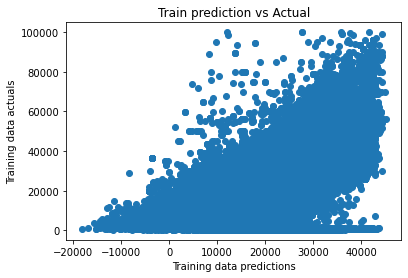

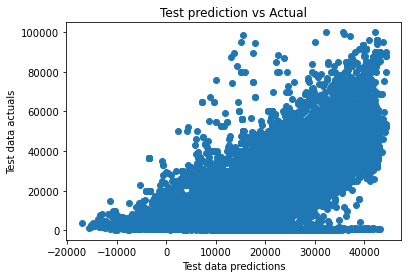

In [42]:
#Plot predicted vs actual 
plt.scatter(pred_train, y_train)
plt.title("Train prediction vs Actual")
plt.xlabel("Training data predictions")
plt.ylabel("Training data actuals")
plt.show()

plt.scatter(pred_test, y_test)
plt.title("Test prediction vs Actual")
plt.xlabel("Test data predictions")
plt.ylabel("Test data actuals")
plt.show()

#The shape of the scatter plot is between train and test are very similar
#There are no predictions above $50k approximately when there are cars sold for upto 250k
#There are negative values of the predicted price, which cannot be true. No one will sell car and pay the buyer money
#Makes me think there is a base value for the car and adjustments need to be made based on odometer, title type, vehicle condition etc. 



In [43]:
#Let me add dummies for size
print(final_data['size'].unique())
print(final_data['size'].isnull().sum(axis=0))
print(final_data['size'].value_counts())

#we cannot afford to drop more than half of the rows that have NaNs. I also do not want to impute the missing value for a 
#categorical feature, as we can only do most_frequent or constant, both will skew the data, especially when there are more
#than 50% of the data that will need to be imputed. Therefore, it might be better to ignore the whole feature in regression

[nan 'full-size' 'mid-size' 'compact' 'sub-compact']
116954
full-size      43495
mid-size       26614
compact        11502
sub-compact     1607
Name: size, dtype: int64


In [44]:
#Let me add drive to the linear regression and see how this changes the predictions
final_data['drive'].unique()
final_data['drive'].isnull().sum(axis=0)

#Drop rows where drive is null
final_data = final_data[final_data['drive'].notna()]

df_temp = pd.get_dummies(final_data['drive'])

final_data = pd.concat([final_data, df_temp], axis = 1)

final_data = final_data.drop(['drive'], axis=1)
final_data.dtypes


region               object
price                 int64
year                float64
manufacturer         object
model                object
cylinders             int64
fuel                 object
odometer            float64
transmission         object
size                 object
type                 object
paint_color          object
state                object
age                 float64
cond_excellent        uint8
cond_fair             uint8
cond_good             uint8
cond_like_new         uint8
cond_salvage          uint8
title_clean           uint8
title_lien            uint8
title_missing         uint8
title_parts_only      uint8
title_rebuilt         uint8
title_salvage         uint8
4wd                   uint8
fwd                   uint8
rwd                   uint8
dtype: object

In [45]:
#run linear regression by adding the drive - fwd, rwd, 4wd

In [46]:
#run linear regression with odometer, vehicle condition, cylinders, Title_status,age against price
linreg = LinearRegression(fit_intercept=False)
X = final_data[['odometer', 'cond_like_new', 'cond_excellent', 'cond_good', 'cond_fair', 'cond_salvage', \
              'cylinders', 'title_clean', 'title_lien', 'title_rebuilt', 'title_salvage', 'title_missing', 'title_parts_only',
              'age', 'fwd', 'rwd', '4wd']]
y = final_data['price']

linreg.fit(X, y)

print(linreg.coef_)
print(linreg.score(X,y))

#expected confidence level to go up, but it dropped slightly

[-6.62299227e-02  2.68924703e+03  2.32644179e+03  2.88810023e+03
  3.26103781e+03  1.66490431e+03  3.28799957e+03  8.88147916e+03
  9.54083158e+03  4.15435394e+03  3.46412152e+03  3.36358951e+03
  5.17386971e+03 -1.21015552e+03  1.53340436e+03  4.62754479e+03
  6.66878202e+03]
0.6004432765452342


In [47]:
#Lets split the data in train and test and calculate MSE

#since we are going to split the data to train and test,data will be automatically shuffled
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=.3)

linreg = LinearRegression(fit_intercept=False)
linreg.fit(X_train, y_train)

pred_train = linreg.predict(X_train)
pred_test = linreg.predict(X_test)

mse_train = mean_squared_error(pred_train, y_train)
mse_test = mean_squared_error(pred_test, y_test)

print(round(mse_train))
print(round(mse_test))

#as expected mse for train is lower than mse for test. MSE for test is very close to the mse of train, which is good

78113125
79814694


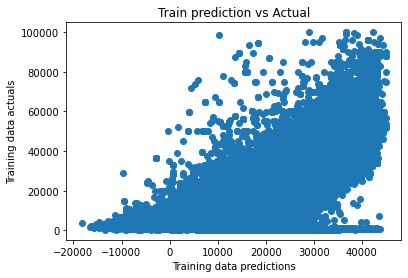

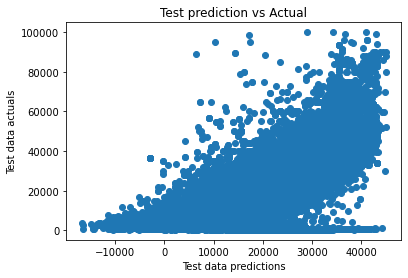

In [48]:
#Plot predicted vs actual 
plt.scatter(pred_train, y_train)
plt.title("Train prediction vs Actual")
plt.xlabel("Training data predictions")
plt.ylabel("Training data actuals")
plt.show()

plt.scatter(pred_test, y_test)
plt.title("Test prediction vs Actual")
plt.xlabel("Test data predictions")
plt.ylabel("Test data actuals")
plt.show()

#The shape of the scatter plot is between train and test are very similar, like before
#There are no predictions above $50k approximately when there are cars sold for upto 250k
#There are negative values of the predicted price, which cannot be true. No one will sell car and pay the buyer money
#Makes me think there is a base value for the car and adjustments need to be made based on odometer, title type, vehicle condition etc. 


In [78]:
#lets run a Ridge regression and calculate the Mean squared error for both train and test data

ridge = Ridge(alpha=.25)
X = final_data[['odometer', 'cond_like_new', 'cond_excellent', 'cond_good', 'cond_fair', 'cond_salvage', \
              'cylinders', 'title_clean', 'title_lien', 'title_rebuilt', 'title_salvage', 'title_missing', 'title_parts_only',
              'age', 'fwd', 'rwd', '4wd']]
y = final_data['price']

ridge.fit(X, y)

print(ridge.coef_)
print(ridge.score(X,y))

#expected confidence level to go up, but it dropped slightly

[-6.62298552e-02  1.22603696e+02 -2.40357798e+02  3.21421846e+02
  6.94321541e+02 -8.97989285e+02  3.28800270e+03  8.87798673e+03
  9.53491032e+03  4.15065061e+03  3.45997088e+03  3.34910377e+03
  5.12485936e+03 -1.21015106e+03 -2.74312312e+03  3.50975466e+02
  2.39214766e+03]
0.600443273396122


In [50]:
#Lets split the data in train and test and calculate MSE

#since we are going to split the data to train and test,data will be automatically shuffled
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=.3)

ridge = Ridge()
ridge.fit(X_train, y_train)

pred_train = ridge.predict(X_train)
pred_test = ridge.predict(X_test)

mse_train = mean_squared_error(pred_train, y_train)
mse_test = mean_squared_error(pred_test, y_test)

print(round(mse_train))
print(round(mse_test))

#as expected mse for train is lower than mse for test. MSE for test is very close to the mse of train, which is good

79193800
77290548


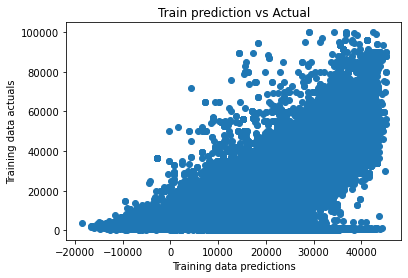

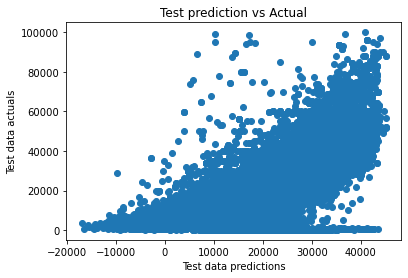

In [51]:
#Plot predicted vs actual 
plt.scatter(pred_train, y_train)
plt.title("Train prediction vs Actual")
plt.xlabel("Training data predictions")
plt.ylabel("Training data actuals")
plt.show()

plt.scatter(pred_test, y_test)
plt.title("Test prediction vs Actual")
plt.xlabel("Test data predictions")
plt.ylabel("Test data actuals")
plt.show()

#The shape of the scatter plot is between train and test are very similar, like before
#There are no predictions above $50k approximately when there are cars sold for upto 250k
#There are negative values of the predicted price, which cannot be true. No one will sell car and pay the buyer money
#Makes me think there is a base value for the car and adjustments need to be made based on odometer, title type, vehicle condition etc. 


In [52]:
final_data['size'].value_counts()

full-size      42094
mid-size       25861
compact        11106
sub-compact     1576
Name: size, dtype: int64

In [83]:
# Use GridSearchCV to find best alpha and then find its score
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline

ridge_pipe = Pipeline([('ridge', Ridge())])

ridge_params = {'ridge__alpha' : [0,.25,.5,.75,1, 1.25, 1.50, 1.75, 2, 2.25, 2.5, 2.75, 3, 4, 5, 6, 7, 8, 9, 25]}

ridge_grid = GridSearchCV(ridge_pipe, param_grid=ridge_params)

X = final_data[['odometer', 'cond_like_new', 'cond_excellent', 'cond_good', 'cond_fair', 'cond_salvage', \
              'cylinders', 'title_clean', 'title_lien', 'title_rebuilt', 'title_salvage', 'title_missing', 'title_parts_only',
              'age', 'fwd', 'rwd', '4wd']]
y = final_data['price']

ridge_grid.fit(X, y)

best_model = ridge_grid.best_estimator_
best_model.fit(X, y)

print(ridge_grid.best_params_)
print(best_model.score(X,y))

best_model.fit(X_train, y_train)
print(best_model.score(X_test, y_test))

{'ridge__alpha': 2.25}
0.6004430451020814
0.604477678855962


### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

In [706]:
#my analysis gave some important findings but by no means it is exhaustive. I was able to hypothesize many things and was 
#was able to validate them. Data needs a lot more cleanup. I was able to run regessions using linear and ridge, but the 
#confidence on the model is lower at less than 60%. I think I have to refine the features further, by doing some feature 
#consolidation. I did not take into account the state impact on the price. Perhaps next step would be to create another column
#and group(cluster) the states as may be north, east, west, south and see whether it improves the model.Transmission could be 
#another thing, that can improve the prediction (auto selling for more price than manual). But buyers of sporty cars, may be 
#interested in manual. Size of the vehicle will also make an impact on price. Full size cars will cost more than the compact or 
#sub compact. 

#MUCH MORE ANALYSIS IS REQUIRED!!!!!!!!

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

In [ ]:
Disclaimer: The report below provides high level guidance on what to inventory. The advice is at a high level and further
    analysis is required for a detailed deep dive to provide more specific guidance.

In [ ]:
1. There are not much data available for classic cars and super expensive cars (above $250k). Hence, were not included
in the modelling.
2. New cars were deliberately not considered as the recommendation is for used car dealerships.
3. State/Region level breakdowns are not included in this initial analysis. They will be covered in a future SOW.
4. 4, 6 and 8 cylinder vehicles were included in the study. Any other speciality # of cylinders 10, 12,5 etc. were ignored 
due to lack of data
5. Any vehicle above 22 years (manufactured before year 2000) have been ignored from the analysis

In [ ]:
6. Odometer, drive type (4wd, rwd, fwd), cylinders (4,6,8), condition of the vehicle, title type and age 
(calculated based on year) were included in the analysis 

In [ ]:
7. Individually all the above features impacted the price

In [ ]:
8. In a joint model using all the above features, I found that 
- There is a negative impact of about 6.6 cents per mile in the odometer
- Like new ,fair, excellent and good condition vehicles had $2k to $3k more pricey
- $3.28k price per cyclinder in the car
- Clean and Lien title fetched more money than rebuilt, missing, salvage titles. There was about $5.5k increase for clean and 
$6k increase for Lien vehicles. 
- For each year that the vehicle is older there was a $1.2k decrease in price per year. 
- RWD vehicles commanded $3k more than FWD. 4WD was about $2k more than RWD vehicles.

* All numbers above have been approximated. For exact numbers, please reach out to me, so I can provide based on the co-efficients.


In [1065]:
(final_data['price'] < 199).sum()

0